# Group 1 - Network Analysis

### Data Science at ITU

## Project name

Group/contact:
- Martin Kirkegaard
- Florian Micliuc (flmi@itu.dk)
- Markus Kristoffer Sibbesen
- Constantin-Bogdan Craciun
- Josephine Tia Højer Holst
- Jacob Andreas Sneding Rohde

Key points about our network:
- directed graph (weighted) (we made it weighted)
- unipartite
- cyclic
- one single strongly connected component (we made it)
- no self-loops (we removed self-loops)

Done so far:
- Description of the network
- Filtering/Cleaning of the datasets
- Statistics
- Visuallysation
- Si-Model
- Communities
- link prediction (not yet)

Questions:
- the direction
- research question
- discussion
- conclusion

Ideas:
- spreading disease or whatever
- crucial nodes/edges
- max flow
- bridges
- Si-model(some kind)

# Project outline (1)

1. Data description - how did we construct the graph? (preprocessing, motivate choices for nodes/edges/weights)
2. Basic properties and statistics
3. **RQ: How does different measures of sturctural importance influence the spread of a potential disease in the SI(/SIR) model? - and which are most impprtant for preventing / stopping the spread?**
4. Propose disease model SI(/SIR): Justify choice of model. Justify edge weight = passengers.
5. Propose candidate metrics for measurinc structural importance of nodes (airport) /edges (routes).

_E.g. degree centrality, bridges/borders/communities, degree, others?_

6. Run different simulations by removing/starting at different nodes/edges. Alter network according to some importance criteria (specify above) and report the consequences / effect.

_What should our measure of 'success' be (e.g. amount of 'steps')?_

7. Discuss the effect on spread with different alterations.
8. Conclude on discussion

### Important assumptions / simplifications to remember
- Accumulated values/weights over the entire year 2013. Assuming a uniform distribution of passengers?
- In our networ, nodes consist of airports - not individuals. Therefore, the mechanism of infecting a node is highly simplified. An entire airport is wither infected or it is not.
- For simplification, the entire network is considered in isolation. This means that infection spreading from airport to airport through other transportation types are not considered.

# Imports

In [23]:
import pandas as pd
import numpy as np
from collections import Counter
import networkx as nx
import random
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=UserWarning)
import folium
#import geojson
#import geopandas
#import mplleaflet
from folium.plugins import HeatMap
import json

# Functions

In [24]:
def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

# I. Data filtering and cleaning

Loading the coordinates data

In [25]:
#airport_info = pd.read_csv("../Data/us-airports.csv",delimiter=",")

In [26]:
#airport_info = airport_info[airport_info["type"] != "closed"] #Removes closed airports

In [27]:
#airport_coord_origin = airport_info[['latitude_deg','longitude_deg']][1:].astype(float)
#airport_coord_origin = airport_coord_origin.rename(columns = {'latitude_deg':'latitude_deg_origin','longitude_deg':'longitude_deg_origin'})
#airport_coord_origin['ORIGIN'] = airport_info['local_code']

In [28]:
#airport_coord_dest = airport_info[['latitude_deg','longitude_deg']][1:].astype(float)
#airport_coord_dest = airport_coord_dest.rename(columns = {'local_code':'DEST','latitude_deg':'latitude_deg_dest','longitude_deg':'longitude_deg_dest'})
#airport_coord_dest['DEST'] = airport_info['local_code']

In [29]:
#with open('../Data/total.json','r') as f:
#    coords = json.load(f)

In [30]:
coords = pd.read_json('../Data/total.json')

In [31]:
coords = coords.T.reset_index()

In [32]:
coords_origin = coords.rename(columns = {'index':'ORIGIN',0:'longitude_origin',1:'latitude_origin'})
coords_dest = coords.rename(columns = {'index':'DEST',0:'longitude_dest',1:'latitude_dest'})

Loading the main dataset and merging everything into 'data_merged'

In [33]:
data_filtered = pd.read_csv('../Data/final_cool_dataset.csv',delimiter = ',')

In [34]:
data_filtered_coord = pd.merge(data_filtered,coords_origin, on = ['ORIGIN'])
data_filtered_coord = pd.merge(data_filtered_coord,coords_dest, on = ["DEST"])

# II. Network generation

In [35]:
graph = data_filtered_coord[['ORIGIN','DEST']]

In [36]:
G = nx.DiGraph()

In [37]:
for i,j in zip(graph['ORIGIN'],graph['DEST']):
    G.add_edge(i,j)

In [38]:
#plt.figure(figsize=(100, 100))
#nx.draw(G, with_labels=True,node_color = 'lightgray',node_size = 10000)

some assortitative degree analysis

In [39]:
r = nx.degree_pearson_correlation_coefficient(G)

In [40]:
print(r)

0.05737487128478884


In [41]:
r1=nx.degree_assortativity_coefficient(G)

In [42]:
print(r1)

0.057374871284788555


In [43]:
nx.average_degree_connectivity(G)

{26: 59.073076923076925,
 118: 65.23305084745763,
 34: 49.67156862745098,
 344: 39.98837209302326,
 27: 52.958847736625515,
 39: 50.965811965811966,
 170: 42.0,
 35: 75.3015873015873,
 46: 35.41925465838509,
 2: 66.63366336633663,
 8: 56.20454545454545,
 25: 51.43,
 28: 54.324675324675326,
 69: 41.16425120772947,
 208: 25.129807692307693,
 47: 29.404255319148938,
 66: 61.66969696969697,
 23: 60.13333333333333,
 30: 45.096296296296295,
 45: 80.32345679012346,
 43: 42.86046511627907,
 37: 37.513513513513516,
 3: 76.76515151515152,
 86: 49.36046511627907,
 20: 57.2,
 24: 62.69583333333333,
 82: 74.57723577235772,
 59: 47.99152542372882,
 6: 53.28431372549019,
 33: 96.83030303030303,
 92: 23.10326086956522,
 41: 49.66898954703833,
 49: 58.173469387755105,
 56: 76.02380952380952,
 29: 69.78817733990148,
 50: 77.635,
 14: 51.316964285714285,
 18: 40.77160493827161,
 88: 27.102272727272727,
 61: 54.377049180327866,
 22: 71.23140495867769,
 21: 48.095238095238095,
 36: 55.317460317460316,
 40:

ASK questions !

In [44]:
nx.average_neighbor_degree(G)

{'ABL': 29.5,
 'OME': 22.721311475409838,
 'AIN': 32.27777777777778,
 'ANC': 42.433734939759034,
 'ATK': 40.61538461538461,
 'AUK': 39.63157894736842,
 'BET': 23.45977011494253,
 'BKC': 34.11764705882353,
 'BRW': 29.73913043478261,
 'CIL': 61.0,
 'DIO': 23.25,
 'DRG': 24.076923076923077,
 'ELI': 34.05882352941177,
 'EMK': 34.0625,
 'FAI': 24.632075471698112,
 'FBK': 32.27272727272727,
 'GAL': 30.96969696969697,
 'GAM': 35.38461538461539,
 'GLV': 33.88235294117647,
 'GMT': 61.0,
 'HPB': 29.14814814814815,
 'HSL': 26.235294117647058,
 'IAN': 25.0,
 'KAL': 43.0,
 'KKA': 37.9375,
 'KOT': 38.65,
 'KPC': 61.0,
 'KSM': 32.1,
 'KTS': 36.63636363636363,
 'KVL': 22.833333333333332,
 'MCG': 25.8,
 'MLL': 35.2,
 'MOS': 50.5,
 'MOU': 37.95652173913044,
 'MRI': 31.3,
 'OBU': 33.611111111111114,
 'OHC': 27.666666666666668,
 'ORV': 27.4375,
 'OTZ': 23.869565217391305,
 'PHO': 31.8,
 'PQS': 32.7037037037037,
 'RBY': 33.142857142857146,
 'SCM': 32.58620689655172,
 'SHH': 21.615384615384617,
 'SKK': 39.0

In [45]:
nx.average_clustering(G)

0.5727644697188189

In [46]:
nx.is_strongly_connected(G)

True

# III. Statistical analysis 

Here we find that the diameter of the graph is 8
This means that you can get from any airport to any airport in at most 8 steps. 
The longest shortest path is 8

In [47]:
nx.diameter(G)

7

This is the average shortest path of the network. Meaning on average if you pick two nodes at random the distance is a path with the length of 3

In [48]:
nx.average_shortest_path_length(G)

3.1051754914896033

Finding the longest shortest paths

In [49]:
li = []
for node in G.nodes():
    start_end_nodes = [(node, k) for k,v in nx.shortest_path_length(G, node).items() if v == 7]
    if start_end_nodes != []:
        li.append(start_end_nodes)

In [50]:
with open("../Data/total.json", "r") as file:
    airport_lookup_table = json.load(file)

In [51]:
airport_lookup_table

{'04A': ['31.7363', '-86.262497'],
 '06A': ['32.460499', '-85.680002'],
 '08A': ['32.5294', '-86.328201'],
 '1B1': ['42.2913017273', '-73.7102966309'],
 '1G4': ['35.985787', '-113.817072'],
 '1N7': ['40.9710998535', '-74.99749755859999'],
 '6B0': ['43.9847984314', '-73.09590148929999'],
 '7AK': ['54.14459', '-165.604332'],
 'A14': ['58.9065', '-157.714'],
 'A26': ['41.18600082397461', '-120.9520034790039'],
 'A27': ['59.439335', '-151.720805'],
 'A29': ['57.052101135253906', '-135.3459930419922'],
 'A40': ['71.057926', '-154.73912'],
 'A63': ['59.07559967041', '-160.27299499512'],
 'ABE': ['40.651773', '-75.442797'],
 'ABI': ['32.4113006592', '-99.68190002440001'],
 'ABL': [67.1, -157.81666666666666],
 'ABQ': ['35.040199', '-106.609001'],
 'ABR': ['45.449100494384766', '-98.42179870605469'],
 'ABY': ['31.532946', '-84.196215'],
 'ACK': ['41.25310135', '-70.06020355'],
 'ACT': ['31.611299514770508', '-97.23049926757812'],
 'ACV': ['40.978101', '-124.109'],
 'ACY': ['39.45759963989258', 

In [52]:
routes = dict()
coord = dict()
for elm in li:
    from_ = elm[0][0]
    #routes[from_] = []
    routes_dict = dict()
    coord_dict = dict()
    for i in elm:
        to_ = i[1]
        shortest_path = nx.shortest_path(G, from_, to_)
        
        routes_dict[to_] = shortest_path
        coord_dict[to_] = [airport_lookup_table[x] for x in shortest_path]
        #airport_name_coordinates
        #coord_dict[to_] = [airport_name_coordinates(x) for x in shortest_path]
    coord[from_] = coord_dict
    routes[from_] = routes_dict

In [53]:
from_ = []
dest_ = []
coordinates = []
path = []
for elm in coord.items():
    fr = elm[0]
    
    for i in elm[1].keys():
        dest_.append(i)
        path.append(routes[fr][i])
        from_.append(fr)
    for i in elm[1].values():
        coordinates.append(i)

In [54]:
d = {"from": from_, "dest": dest_, "path": path, "coordinates": coordinates}
df_paths = pd.DataFrame(data=d)
df_paths.to_csv('../Data/to_florian_dataframe_longest_paths.csv', index=False)

Centrality

In graph theory and network analysis, indicators of centrality assign numbers or rankings to nodes within a graph corresponding to their network position. Applications include identifying the most influential person(s) in a social network,

In [55]:
sorted_degree_centrality = sorted(nx.degree_centrality(G).items(), key=lambda x: x[1], reverse=True)
sorted_degree_centrality = [x[0] for x in sorted_degree_centrality[0:20]]
#These are the most "central" nodes in the graph
sorted_degree_centrality

['ATL',
 'MSP',
 'DEN',
 'ORD',
 'DFW',
 'ANC',
 'MEM',
 'DTW',
 'IAH',
 'LAS',
 'LAX',
 'SDF',
 'IAD',
 'YIP',
 'EWR',
 'CLT',
 'IND',
 'BUR',
 'BWI',
 'MIA']

Clustering coefficient

In [56]:
#The average clustering coefficient of the network is 0.56
nx.average_clustering(G)

0.5727644697188189

In [57]:
#Clustering for nodes
clustering = nx.clustering(G)
clustering_sorted = sorted(clustering.items(), key=lambda x: x[1], reverse=True)
clustering_sorted

[('DIO', 1.0),
 ('KPC', 1.0),
 ('MOS', 1.0),
 ('OHC', 1.0),
 ('04A', 1.0),
 ('A26', 1.0),
 ('A63', 1.0),
 ('AK5', 1.0),
 ('CKX', 1.0),
 ('CZN', 1.0),
 ('HGZ', 1.0),
 ('LIV', 1.0),
 ('ORT', 1.0),
 ('UUK', 1.0),
 ('7AK', 1.0),
 ('DRF', 1.0),
 ('MDO', 1.0),
 ('MXY', 1.0),
 ('NCN', 1.0),
 ('PUO', 1.0),
 ('TEK', 1.0),
 ('A29', 1.0),
 ('BFB', 1.0),
 ('DGB', 1.0),
 ('SKJ', 1.0),
 ('08A', 1.0),
 ('SOV', 1.0),
 ('GUS', 1.0),
 ('MTP', 1.0),
 ('ELD', 1.0),
 ('BRL', 1.0),
 ('DEC', 1.0),
 ('VAD', 1.0),
 ('CWF', 1.0),
 ('BWD', 1.0),
 ('HSH', 1.0),
 ('SCH', 1.0),
 ('CLD', 1.0),
 ('HIO', 1.0),
 ('LVK', 1.0),
 ('LWC', 1.0),
 ('NEW', 1.0),
 ('RAC', 1.0),
 ('SBD', 1.0),
 ('SCF', 1.0),
 ('MZJ', 1.0),
 ('VCT', 1.0),
 ('GBD', 1.0),
 ('MCK', 1.0),
 ('SVC', 1.0),
 ('ALW', 1.0),
 ('CLM', 1.0),
 ('MVW', 1.0),
 ('WYS', 1.0),
 ('DVN', 1.0),
 ('GSH', 1.0),
 ('IKV', 1.0),
 ('MVN', 1.0),
 ('OTM', 1.0),
 ('SGH', 1.0),
 ('AXV', 1.0),
 ('LKK', 1.0),
 ('RBH', 1.0),
 ('PCA', 1.0),
 ('KCR', 1.0),
 ('MDR', 1.0),
 ('WOW', 1

In [58]:
#Clustering coefficient plottet

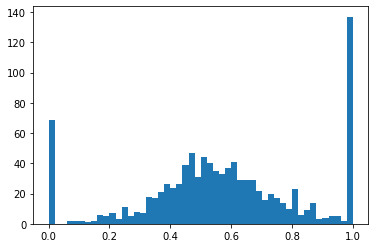

In [59]:
t = [x[1] for x in clustering_sorted]
plt.hist(t, bins = 50);

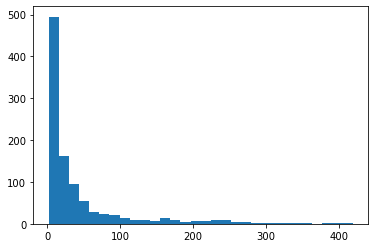

In [60]:

def plot_degree_dist(G):
    degrees = [G.degree(n) for n in G.nodes()]
    plt.hist(degrees, bins = 30)
    plt.show()

plot_degree_dist(G)

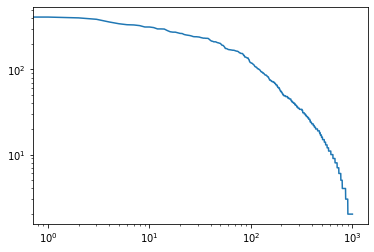

In [61]:
#Degree distribution
def plot_degree_dist(G):
    degrees = [G.degree(n) for n in G.nodes()]
    degrees = sorted(degrees, reverse= True)
    plt.loglog(degrees)
    plt.show()

plot_degree_dist(G)

# IV. Map visualization

In [62]:
x_zip = list(zip(data_filtered_coord['latitude_origin'],data_filtered_coord['latitude_dest']))
y_zip = list(zip(data_filtered_coord['longitude_origin'],data_filtered_coord['longitude_dest']))

In [63]:
coords_name_df = pd.DataFrame()
coords_name_df['ORIGIN'] = data_filtered_coord['ORIGIN']
coords_name_df['COORDS'] = list(zip(data_filtered_coord['latitude_origin'],data_filtered_coord['longitude_origin']))

In [64]:
coords_name_df = coords_name_df.drop_duplicates()

Using matplotlib and mplleaflet(if you install mplleaflet you need to change something in the source code so remind me to tell you how)

In [65]:
norm_pass = NormalizeData(data_filtered['PASSENGERS'])
pass_count = []
for i in norm_pass:
    if i < 0.95:
        i+= 0.05
    pass_count.append(i)

In [66]:
fig,ax = plt.subplots(figsize = (400,150))
for i, (x,y) in enumerate(zip(x_zip,y_zip)):
    ax.plot(x,y,'grey',alpha = pass_count[i])
ax.scatter(x_zip,y_zip)
plt.show()

using networkx

In [67]:
G = nx.DiGraph()

In [68]:
pos = dict()
for i,j in zip(coords_name_df['ORIGIN'],coords_name_df['COORDS']):
    pos[i] = (j[0],j[1])
    G.add_node(i)

In [69]:
for i,j in zip(data_filtered_coord['ORIGIN'],data_filtered_coord['DEST']):
    G.add_edge(i,j,edge_color = 'lightgray')

In [70]:
nx.is_strongly_connected(G)

True

In [71]:
fig,ax = plt.subplots(figsize = (400,150))
nx.draw(G,pos = pos,ax = ax,with_labels = True,font_color = 'white',node_size = 5000)
plt.show()

In [167]:
dict_out = {}

for i, row in graph.iterrows():
    dict_out.setdefault(row[0], []).append(row[1])

dict_in = {}
for i, row in graph.iterrows():
    dict_in.setdefault(row[1], []).append(row[0])
dict_in['BRL']
    

    

['ORD', 'STL']

In [168]:
## Link prediction
## Commom neighbors in and out

def common_out(g,i,j):
    return set(g.successors(i)).intersection(g.successors(j))
#common_out(G, graph[0], graph[1])

def common_in(g,i,j):
    return set(g.predecessors(i)).intersection(g.predecessors(j))

list_air = set()
for i, row in graph.iterrows():
    list_air.add(row[0])
    list_air.add(row[1])
    
#print(len(list_air))
airports = list(list_air)

dict_jaccard = {}


list_of_neig_in = []
for i in range(len(airports)-1):
    for j in range(i+1, len(airports)):
        #print('Common neig_in for ', airports[i], ' and ', airports[j], ' are ', common_in(G, airports[i], airports[j]))
        x , y = set(dict_in[airports[i]]), set(dict_in[airports[j]])
        z = float(len(common_in(G, airports[i], airports[j])))/float(len(x.union(y)))
        
        dict_jaccard.setdefault(str(airports[i])+str(airports[j]), []).append(z)
        
dict_jaccard

    
    




{'LASOTH': [0.03289473684210526],
 'LASPIB': [0.057692307692307696],
 'LASSWF': [0.19375],
 'LASLUR': [0.006493506493506494],
 'LASRBY': [0.0],
 'LASTEK': [0.006622516556291391],
 'LASPSK': [0.0],
 'LASWJF': [0.006711409395973154],
 'LASHRO': [0.019867549668874173],
 'LASFOK': [0.025974025974025976],
 'LASPDK': [0.013422818791946308],
 'LASRIC': [0.29842931937172773],
 'LASTNC': [0.006369426751592357],
 'LASGAI': [0.0],
 'LASDVN': [0.006666666666666667],
 'LASHVR': [0.006666666666666667],
 'LASTKE': [0.0],
 'LASHTS': [0.0625],
 'LASPKB': [0.026143790849673203],
 'LASTXK': [0.05194805194805195],
 'LASPAQ': [0.006134969325153374],
 'LASLBF': [0.019736842105263157],
 'LASKQA': [0.006535947712418301],
 'LASGRK': [0.1144578313253012],
 'LASKPR': [0.0],
 'LASIDA': [0.09740259740259741],
 'LASMWA': [0.04],
 'LASMEO': [0.0],
 'LASLWC': [0.006711409395973154],
 'LASVLD': [0.019736842105263157],
 'LASPNE': [0.0],
 'LASEWN': [0.01935483870967742],
 'LASMUE': [0.0],
 'LASEWB': [0.0],
 'LAS7AK': [0

In [170]:
l2 = []
for key, value in dict_jaccard.items():
    if value[0] == 1:
        l2.append(key)
l2

127

In [156]:
for i, row in graph.iterrows():
    if row[0] == 'BRL':
        print(row[0], row[1])
#print(dict_in['DEC'])

BRL ORD
BRL STL


In [118]:
### Jaccard'score: A ∩ B / A u B 

,ORIGIN,DEST
0,ABL,OME
1,AIN,OME
2,ANC,OME
3,ATK,OME
4,AUK,OME
...,...,...
995,ANC,ANI
996,BET,ANI
997,EMK,ANI
998,FAI,ANI


# V. Research question

# Martin (done by Florian) 😍🤯😤

Longest shortest paths
redo!!!!!

In [32]:
data1 = pd.read_csv("../Data/to_florian_dataframe_longest_paths.csv",delimiter=",")

In [253]:
list1 = []
for i in data1['coordinates']:
    list1.append([eval(i)])

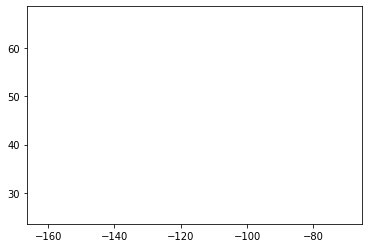

In [204]:
for i in list1:
    for j in i:
        if type(j[0]) is str or type(j[1]) is str:
            j_0 = [eval(j[0])]
            j_1 = [eval(j[1])]
            plt.plot(j_1,j_0)
            bst1.append(list(zip(j_0,j_1)))

In [53]:
coords_list = []
for i in coords:
    for j in i:
        coords_list.append(j)

In [54]:
split_coords = []
for i in range(1,len(coords_list)):
    split_coords.append(coords_list[i-1:i+1])

In [55]:
names = []
for i in data1['path']:
    names.append(eval(i))

In [56]:
names_list = []
for i in names:
    for j in i:
        names_list.append(j)

In [57]:
split_names = []
for i in range(1, len(names_list)):
    split_names.append(tuple(names_list[i-1:i+1]))

Doing stuff because Martin wanted some labels 😘

In [58]:
map1 = folium.Map()

In [59]:
for origin,name in zip(coords_list,names_list):
        folium.Marker(location= origin ,popup = name,icon=folium.Icon(color='lightgray', icon='plane',prefix = 'fa')).add_to(map1)

In [60]:
for i in range(len(split_coords)):
    folium.PolyLine(split_coords[i],popup = split_names[i],color = 'lightgray').add_to(map1)

Degree centrality

In [262]:
data2 = pd.read_csv('../Data/to_florian_dataframe_degree_centrality.csv')

In [263]:
org = list(zip(data2['ORIGIN_LAT'],data2['ORIGIN_LONG']))

In [264]:
org = np.array(org)

In [265]:
plt.scatter(org[:,1],org[:,0])
mplleaflet.show()

Clustering coefficient

In [266]:
data3 = pd.read_csv('../Data/to_florian_clustering_coefficient.csv')

In [267]:
org1 = list(zip(data3['ORIGIN_LAT'],data3['ORIGIN_LONG']))

In [268]:
org1 = pd.DataFrame(org1)

In [269]:
org1['weight'] = data3['COEFFICIENT']

In [270]:
plt.scatter(org1[1],org1[0])
mplleaflet.show()

In [271]:
#heatmap

In [272]:
map_osm = folium.Map()

In [273]:
HeatMap(org1).add_to(map_osm);

In [274]:
map_osm